# Building a car classifier

Let's look at a slightly more interesting visual example than character or digit classification. Classifying cars. We'll use the Cars dataset from Jonathan Krause et al. at Stanford -- 16,185 images in 196 classes:

http://ai.stanford.edu/~jkrause/cars/car_dataset.html

(Bonus: I just discovered a recent paper that uses similar analysis: [Using Deep Learning and Google Street View to Estimate the Demographic Makeup of the US](https://arxiv.org/pdf/1702.06683.pdf))


## Goal: showing my work

The goal is to show all the steps of exploration and tuning on a new dataset, including false starts, etc. I deliberately didn't read lots of papers on this specific dataset or application, to better simulate working on an unfamiliar problem. I also didn't refactor the code to be prettier or remove things that aren't really needed. If you want to see how to use a particular technique, there are more concise guides out there. 

The plan going in:

- Load the dataset and do preliminary exploration. Since we're starting with a pre-labeled dataset we get to skip all the data cleaning.
- Do some preprocessing to prepare for building a model.
- Build a toy model on a small piece of the dataset to get a pipeline working
- Try to build an SUV/car/other classifier using just these images.
- Try transfer learning by fine-tuning squeezenet
- See how much we can gain via data augmentation
- Try the classifer on new images from the internet...
- if we want to go crazy, we can scrape a bunch more car photos from the internet and try out unsupervised pre-training. May be too much for this example.

Note: if you try to run this notebook, make sure you have lots of RAM (I have 16GB) -- it isn't very careful about memory use.

# Set up the notebook

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
# system
import os
import glob
import itertools as it
import operator
from collections import defaultdict
from StringIO import StringIO

# other libraries
import numpy as np 
import pandas as pd
import scipy.io  # for loading .mat files
import scipy.misc # for imresize
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import seaborn as sns
import requests

In [5]:
# my code -- various helpful utilities
from display import visualize_keras_model, plot_training_curves
from helpers import combine_histories

Using TensorFlow backend.


In [6]:
%matplotlib inline
sns.set_style("white")
p = sns.color_palette()

# repeatability:
np.random.seed(42)

In [7]:
data_root = os.path.expanduser("~/data/cars")

# Data exploration

I've already downloaded and unzipped the dataset. Let's see how it's organized.

In [8]:
os.listdir(data_root)

['car_ims', 'car_ims.tgz', 'cars_annos.mat', 'resized_car_ims', 'source.txt']

Let's look at the annotations first. It's a matlab file; luckily scipy has a function to load it.

In [9]:
cars_annos = scipy.io.loadmat(os.path.join(data_root, 'cars_annos.mat'))

In [10]:
cars_annos.keys()

['annotations', '__version__', '__header__', 'class_names', '__globals__']

## What classes do we have?

Class names seems promising. Let's take a look.

In [8]:
cars_annos['class_names']

array([[array([u'AM General Hummer SUV 2000'], 
      dtype='<U26'),
        array([u'Acura RL Sedan 2012'], 
      dtype='<U19'),
        array([u'Acura TL Sedan 2012'], 
      dtype='<U19'),
        array([u'Acura TL Type-S 2008'], 
      dtype='<U20'),
        array([u'Acura TSX Sedan 2012'], 
      dtype='<U20'),
        array([u'Acura Integra Type R 2001'], 
      dtype='<U25'),
        array([u'Acura ZDX Hatchback 2012'], 
      dtype='<U24'),
        array([u'Aston Martin V8 Vantage Convertible 2012'], 
      dtype='<U40'),
        array([u'Aston Martin V8 Vantage Coupe 2012'], 
      dtype='<U34'),
        array([u'Aston Martin Virage Convertible 2012'], 
      dtype='<U36'),
        array([u'Aston Martin Virage Coupe 2012'], 
      dtype='<U30'),
        array([u'Audi RS 4 Convertible 2008'], 
      dtype='<U26'),
        array([u'Audi A5 Coupe 2012'], 
      dtype='<U18'),
        array([u'Audi TTS Coupe 2012'], 
      dtype='<U19'),
        array([u'Audi R8 Coupe 2012'], 
  

Funny structure. Let's turn it into a flat list.

In [11]:
classes = [x[0] for x in cars_annos['class_names'][0]]
classes[:10]

[u'AM General Hummer SUV 2000',
 u'Acura RL Sedan 2012',
 u'Acura TL Sedan 2012',
 u'Acura TL Type-S 2008',
 u'Acura TSX Sedan 2012',
 u'Acura Integra Type R 2001',
 u'Acura ZDX Hatchback 2012',
 u'Aston Martin V8 Vantage Convertible 2012',
 u'Aston Martin V8 Vantage Coupe 2012',
 u'Aston Martin Virage Convertible 2012']

Looks good. Now let's split into (brand, model, type, year tuples). This will require a bit of manual munging...

In [12]:
first, years = zip(*[(s[:-5], s[-4:])
                     for s in classes])

In [13]:
# Check years...
sorted(pd.unique(years))

[u'1991',
 u'1993',
 u'1994',
 u'1997',
 u'1998',
 u'1999',
 u'2000',
 u'2001',
 u'2002',
 u'2006',
 u'2007',
 u'2008',
 u'2009',
 u'2010',
 u'2011',
 u'2012']

In [14]:
first[:5]

(u'AM General Hummer SUV',
 u'Acura RL Sedan',
 u'Acura TL Sedan',
 u'Acura TL Type-S',
 u'Acura TSX Sedan')

In [15]:
# Ok, let's pull out the car types
models, car_types = zip(*[(s.split()[:-1], s.split()[-1])
                         for s in first])

In [16]:
pd.unique(car_types)

array([u'SUV', u'Sedan', u'Type-S', u'R', u'Hatchback', u'Convertible',
       u'Coupe', u'Wagon', u'GS', u'Cab', u'ZR1', u'Z06', u'SS', u'Van',
       u'Minivan', u'SRT-8', u'SRT8', u'Abarth', u'SuperCab', u'IPL',
       u'XKR', u'Superleggera'], dtype=object)

## What do the images look like?

Hmm. Car types are a bit messy -- many are multi-word. We'll want to clean this up later -- I don't know cars well enough to classify without seeing example images, so let's go to that.

In [17]:
images_dir = os.path.join(data_root, "car_ims")
len(os.listdir(images_dir))

16185

Ok, so we have our 16K images. Let's look at a few random ones.

In [18]:
image_paths[12]

'000013.jpg'

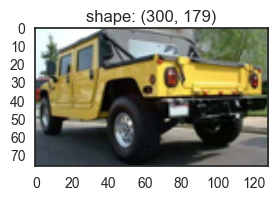

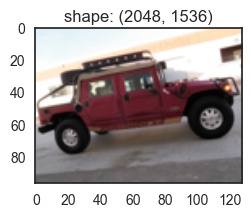

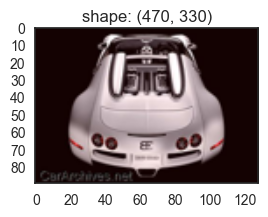

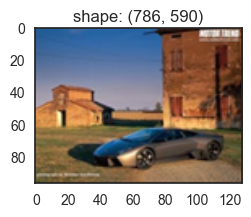

In [19]:
image_paths = os.listdir(images_dir)
for i in [12, 35, 3600, 12345]:
    img = Image.open(os.path.join(images_dir, image_paths[i]))
    size = img.size # save, since we're about to change it
    img.thumbnail((128, 128)) # mostly to make notebook file smaller
    fig, ax = plt.subplots(figsize=(3,2))
    ax.imshow(img)
    ax.set_title('shape: '+ str(size))
    ax.grid(False)

Ok, we can read the images. They appear to be of vastly different sizes. Let's take a closer look.

In [20]:
shapes = [Image.open(os.path.join(images_dir, path)).size
          for path in image_paths]

No errors! It's nice to have clean data...

In [21]:
widths = [s[0] for s in shapes]
aspect_ratios = [s[0]/float(s[1]) for s in shapes]

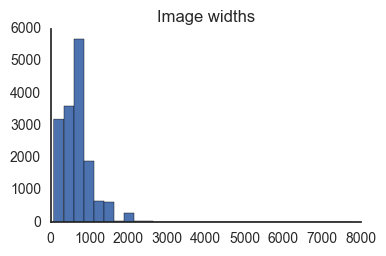

In [78]:
fig, ax = plt.subplots(figsize=(4,2.5))
ax.set_title("Image widths")
ax.hist(widths, bins=30)
sns.despine(fig)

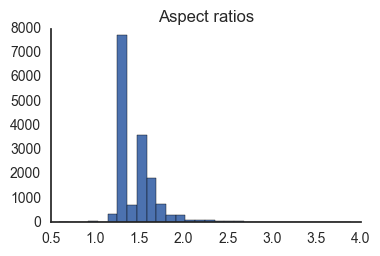

In [79]:
fig, ax = plt.subplots(figsize=(4,2.5))
ax.set_title("Aspect ratios")
ax.hist(aspect_ratios, bins=30);
sns.despine(fig)


Essentially all images are in landscape orientation, and aren't too big--less than 1500px wide. A significant number are pretty small -- just a few hundred pixels. That's probably ok for us -- we'll want scale down for performance reasons anyway.

## Mapping classes and images

Ok, now let's get the classes for each image -- we need to look at the annotations part of the dict... 

In [34]:
len(cars_annos['annotations'])

1

In [35]:
len(cars_annos['annotations'][0])

16185

In [36]:
cars_annos['annotations'][0][0]

([u'car_ims/000001.jpg'], [[112]], [[7]], [[853]], [[717]], [[1]], [[0]])

In [37]:
# what are the fields?
cars_annos['annotations'].dtype

dtype([('relative_im_path', 'O'), ('bbox_x1', 'O'), ('bbox_y1', 'O'), ('bbox_x2', 'O'), ('bbox_y2', 'O'), ('class', 'O'), ('test', 'O')])

In [24]:
# get rid of the nested arrays
from collections import namedtuple
Example = namedtuple('Example',
                     ['rel_path', 'x1', 'y1', 'x2','y2','cls','test'])
# silly nested nested lists...
examples = [Example(*[a.flatten()[0] for a in x])
           for x in cars_annos['annotations'][0]]

In [39]:
examples[0]

Example(rel_path=u'car_ims/000001.jpg', x1=112, y1=7, x2=853, y2=717, cls=1, test=0)

Ok, that worked. Now let's look at a couple of images from each class.

In [26]:
key_fn = operator.attrgetter('cls')
by_class = {} # key -> lst
for cls, group in it.groupby(sorted(examples, key=key_fn), key_fn):
    by_class[cls] = list(group) 

In [27]:
sorted(by_class.keys())[:5]  # note: classes start at 1, not 0

[1, 2, 3, 4, 5]

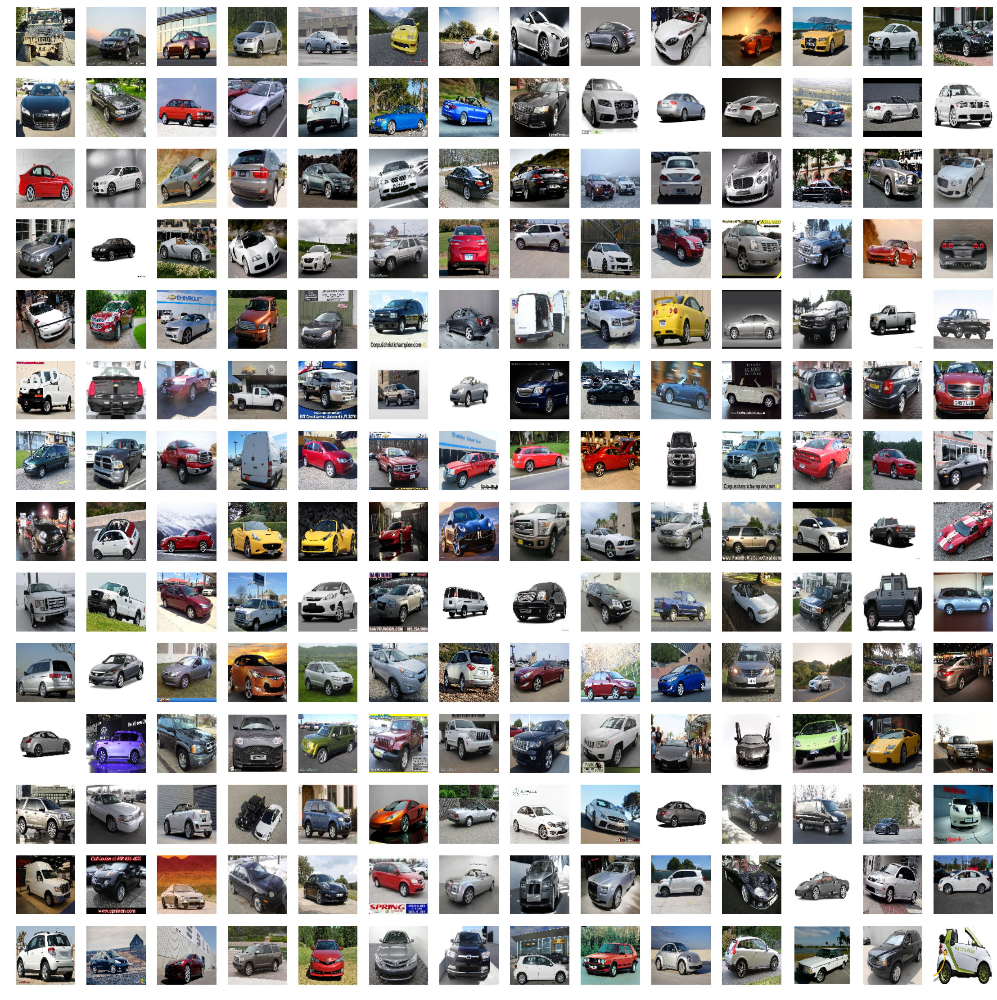

In [42]:
# 196 = 14*14
fig, plots = plt.subplots(14,14, sharex='all', sharey='all',
                         figsize=(28,28))
for i in range(196):
    # read the image
    rel_path = by_class[i+1][0].rel_path
    # Note: rel_paths include 'car_ims/'
    img = Image.open(os.path.join(data_root, rel_path))
    img = img.resize((100,100))
    plots[i // 14, i % 14].axis('off')
    plots[i // 14, i % 14].imshow(img)


Pretty! :)

In [28]:
# Which classes have the most examples?
counts = sorted([(k, classes[k-1], len(by_class[k]))
                 for k in by_class.keys()], 
                reverse=True,
               key=operator.itemgetter(2))

5 most frequent:

(119, u'GMC Savana Van 2012', 136)
(79, u'Chrysler 300 SRT-8 2010', 97)
(161, u'Mercedes-Benz 300-Class Convertible 1993', 96)
(167, u'Mitsubishi Lancer Sedan 2012', 95)
(56, u'Chevrolet Corvette ZR1 2012', 93)

5 least frequent:

(175, u'Rolls-Royce Phantom Drophead Coupe Convertible 2012', 61)
(64, u'Chevrolet Express Cargo Van 2007', 59)
(158, u'Maybach Landaulet Convertible 2012', 58)
(99, u'FIAT 500 Abarth 2012', 55)
(136, u'Hyundai Accent Sedan 2012', 48)


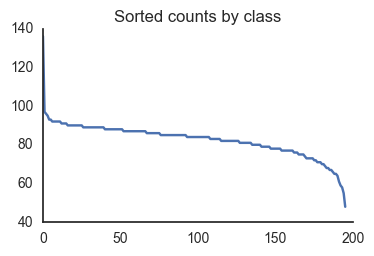

In [80]:
print("5 most frequent:\n")
print("\n".join(map(str, counts[:5])))
print("\n5 least frequent:\n")
print("\n".join(map(str, counts[-5:])))
fig, ax = plt.subplots(figsize=(4,2.5))

ax.plot(range(len(counts)), [x[2] for x in counts])
ax.set_title("Sorted counts by class")
sns.despine(fig)

# Preprocessing the images

Ok, now that we have a sense of what the dataset looks like, let's do some preprocessing.


- We'll want fixed size (227x227) images. Will need to decide whether to just resize, use the provided bounding boxes, resize + crop, etc. (227 is the magic size used by imagenet -- we'll use their classifiers later)
- may also want to convert to grayscale.
- For now, let's just resize all to 227x227. It'll screw up the aspect ratios a bit, but is a reasonable place to start. How much space will that take if we store the images uncompressed?


In [45]:
# 12 bytes per pixel. Size in MB.
16100 * 227 * 227 * 12 / 1024 / 1024

9494

9.5G is a bit much. Let's keep in jpg for now, and decode on the fly. (Could try both and see what's faster...)

In [31]:
resized_path = os.path.join(data_root,'resized_car_ims')
if not os.path.exists(resized_path):
    os.mkdir(resized_path)    

In [133]:
# Resize all the things. Will take a little while.
for fname in image_paths:
    new_path = os.path.join(resized_path, fname)
    # skip if already exists. 
    # (Blow away whole directory if there's a problem, or to change
    # resize strategy)
    if not os.path.exists(new_path):
        img = Image.open(os.path.join(images_dir, fname))
        img = img.resize((227,227))
        img.save(new_path)

In [32]:
# double check
len(os.listdir(resized_path))

16185

In [48]:
!du -shc {resized_path} {images_dir}

219M	/Users/shnayder/data/cars/resized_car_ims
1.9G	/Users/shnayder/data/cars/car_ims
2.1G	total


Get a smaller dataset to process. Will make for faster processing.

# Solve a toy problem

Ok, now we have standard size images and roughly understand what things look like. Let's start with a toy problem to get our code working.

**Problem 1: distinguishing Hummers from the Acura sedan.**

These happen to be the first two classes, and it seems to be a relatively simple task -- certainly for humans. 

In [83]:
# here are our classes
classes[:2]

[u'AM General Hummer SUV 2000', u'Acura RL Sedan 2012']

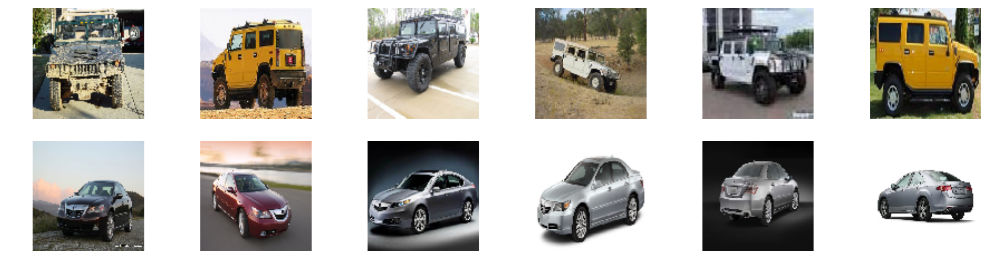

In [87]:
# and here are a few images for each
fig, plots = plt.subplots(2,6, sharex='all', sharey='all',
                         figsize=(24,6))
for i in range(2):
    for j in range(6):
        # read the image
        rel_path = by_class[i+1][j].rel_path
        # Note: rel_paths include 'car_ims/'
        img = Image.open(os.path.join(data_root, rel_path))
        img = img.resize((100,100))
        plots[i, j].axis('off')
        plots[i, j].imshow(img)


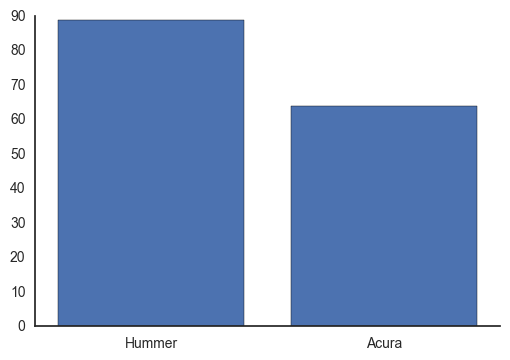

In [95]:
# How many examples do we have?
fig, ax = plt.subplots()
ax.bar([1,2], [len(by_class[i]) for i in [1,2]], tick_label=["Hummer", "Acura"], align="center")
sns.despine(fig)

## Step 1: load and prepare the data

Let's get our training, validation, and test data prepared. We'll just keep it in-memory, at least for now.

In [33]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Convolution2D, MaxPooling2D
from keras.utils import np_utils

# https://github.com/fchollet/keras/issues/4499
from keras.layers.core import K
from keras.callbacks import TensorBoard

# for name scopes to make TensorBoard look prettier 
# (doesn't work well yet as of Keras 1.x -- maybe better in 2.x)
import tensorflow as tf 

In [34]:
def gray_to_rgb(im):
    """
    Noticed (due to array projection error in code below) that there is at least
    one grayscale image in the dataset.
    We'll use this to convert.
    """
    w, h = im.shape
    ret = np.empty((w,h,3), dtype=np.uint8)
    ret[:,:,0] = im
    ret[:,:,1] = im
    ret[:,:,2] = im
    return ret

In [35]:
def load_examples(by_class, cls, limit=None):
    """
    Load examples for a class. Ignores test/train distinction -- 
    we'll do our own train/validation/test split later.
    
    Args:
        by_class: our above dict -- class_id -> [Example()]
        cls: which class to load
        limit: if not None, only load this many images.
        
    Returns:
        list of (X,y) tuples, one for each image.
            X: 227x227x3 ndarray of type uint8
            Y: class_id (will be equal to cls)
    """
    res = []
    to_load = by_class[cls]
    if limit:
        to_load = to_load[:limit]

    for ex in to_load:
        # load the resized image!
        img_path = os.path.join(data_root, 
                        ex.rel_path.replace('car_ims', 'resized_car_ims'))
        img = mpimg.imread(img_path)
        # handle any grayscale images
        if len(img.shape) == 2:
            img = gray_to_rgb(img)
        res.append((img, cls))
    return res

## Split into training, validation, and test sets

Train network on training data, tune parameters using validation set, and finally see how well we did on the test set.

In [36]:
def split_examples(xs, valid_frac, test_frac):
    """
    Randomly splits the xs array into train, valid, test, with specified 
    percentages. Rounds down.
    
    Returns:
        (train, valid, test)
    """
    assert valid_frac + test_frac < 1
    
    n = len(xs)
    valid = int(valid_frac * n)
    test = int(test_frac * n)
    train = n - valid - test
    
    # don't change passed-in list
    shuffled = xs[:]
    np.random.shuffle(shuffled)

    return (shuffled[:train], 
            shuffled[train:train + valid], 
            shuffled[train + valid:])

# quick test
split_examples(range(10), 0.2, 0.4)

([8, 1, 5, 0], [7, 2], [9, 4, 3, 6])

In [53]:
valid_frac = 0.2
test_frac = 0.2
# load the Hummer and acura images
(train, valid, test) = split_examples(load_examples(by_class, 1),
                                     valid_frac, test_frac)
(train2, valid2, test2) = split_examples(load_examples(by_class, 2),
                                     valid_frac, test_frac)

train.extend(train2)
valid.extend(valid2)
test.extend(test2)

# ...and shuffle to make training work better.
np.random.shuffle(train)
np.random.shuffle(valid)
np.random.shuffle(test)

In [54]:
# We have lists of (X,Y) tuples. Let's unzip into lists of Xs and Ys.
X_train, Y_train = zip(*train)
X_valid, Y_valid = zip(*valid)
X_test, Y_test = zip(*test)

# and turn into np arrays of the right dimension.
def convert_X(xs):
    '''
    Take list of (w,h,3) images.
    Turn into an np array, change type to float32.
    '''
    return np.array(xs).astype('float32')
    
X_train = convert_X(X_train)
X_valid = convert_X(X_valid)
X_test = convert_X(X_test)

In [56]:
# Note that despite lots of Keras examples online that want the data to
# have shape 3,w,h, we actually want w,h,3 when using the TensorFlow
# backend.
X_train.shape

(95, 227, 227, 3)

## Convert labels to one-hot.

Two notes here:

1. One hot means converting numbers 0-K into vectors of length K+1: 0 becomes 1,0,0,0; 1 becomes 0,1,0,0; etc. 
2. Because we only have two classes, could actually use a simple binary classifier, but I'm using one-hot because we'll want to classify into more classes later.

First, we need to make sure they're sequential starting from 0. 

In [57]:
all_ys = sorted(set(Y_train).union(set(Y_valid)).union(set(Y_test)))
n_classes = len(all_ys)
mapping = dict(zip(all_ys, range(n_classes)))
mapping

{1: 0, 2: 1}

In [58]:
def convert_Y(ys, mapping):
    '''
    Convert to np array, make class values sequential from 0, 
    and make one-hot
    '''
    ret = np.array([mapping[y] for y in ys])
    n_classes = len(mapping)
    return np_utils.to_categorical(ret, n_classes)

Y_train = convert_Y(Y_train, mapping)
Y_valid = convert_Y(Y_valid, mapping)
Y_test = convert_Y(Y_test, mapping)

In [59]:
Y_train.shape

(95, 2)

## Toy approach: logistic classifier

Let's build a simple logistic classifier. We'll convert to grayscale to reduce number of params by factor of 3.

In [60]:
X_train[0].mean(axis=2).shape

(227, 227)

In [ ]:
def normalize_to_gray(xs):
    """Convert vals to [0,1], reshape into flat vector.
    Just averaging the three channels, even though that's not the optimal way to do it.
    """
    ret = (xs / 255.0).mean(axis=3)
    return np.reshape(ret, (-1, 227*227))

X_train_gray = normalize_to_gray(X_train)
X_valid_gray = normalize_to_gray(X_valid)
X_test_gray = normalize_to_gray(X_test)

In [62]:
X_train_gray[0].shape

(51529,)

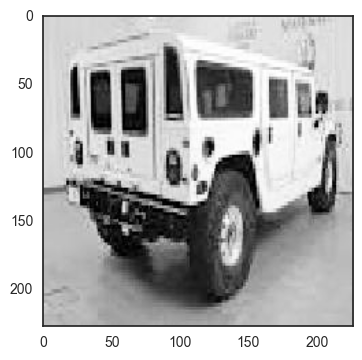

In [63]:
# (1-x) because grayscale images are backwards--1 is black, it appears
plt.imshow((1 - X_train_gray[0]).reshape((227,227)))

## First "network" -- one layer

In [64]:
def logistic_model():
    model = Sequential()
    # should really use lower resolution if we're making this silly
    # of a model
    model.add(Dense(output_dim=2, input_dim=227*227))
    model.add(Activation('softmax'))

    return model

model = logistic_model()
model.compile(loss='categorical_crossentropy',
              optimizer='adadelta',
              metrics=['accuracy'])

In [65]:
Y_train.shape

(95, 2)

In [66]:
history = model.fit(X_train_gray, Y_train,
                    batch_size=16, nb_epoch=100, verbose=1,
         validation_data=(X_valid_gray, Y_valid))

Train on 95 samples, validate on 29 samples
Epoch 1/100
95/95 [==============================] - 0s - loss: 7.2522 - acc: 0.3579 - val_loss: 5.0068 - val_acc: 0.5862
Epoch 2/100
95/95 [==============================] - 0s - loss: 4.9483 - acc: 0.5263 - val_loss: 2.0935 - val_acc: 0.4138
Epoch 3/100
95/95 [==============================] - 0s - loss: 3.2909 - acc: 0.5684 - val_loss: 7.3005 - val_acc: 0.4138
Epoch 4/100
95/95 [==============================] - 0s - loss: 2.6830 - acc: 0.6211 - val_loss: 2.9015 - val_acc: 0.6897
Epoch 5/100
95/95 [==============================] - 0s - loss: 2.4143 - acc: 0.6211 - val_loss: 2.2550 - val_acc: 0.7586
Epoch 6/100
95/95 [==============================] - 0s - loss: 3.4747 - acc: 0.5684 - val_loss: 1.4511 - val_acc: 0.7241
Epoch 7/100
95/95 [==============================] - 0s - loss: 1.2240 - acc: 0.7579 - val_loss: 1.7592 - val_acc: 0.5172
Epoch 8/100
95/95 [==============================] - 0s - loss: 4.9564 - acc: 0.4632 - val_loss: 3.531

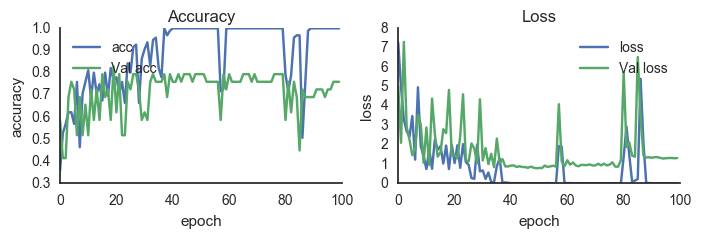

In [67]:
plot_training_curves(history.history);

In [68]:
score = model.evaluate(X_test_gray, Y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

('Test loss:', 1.5162569284439087)
('Test accuracy:', 0.72413790225982666)


In [69]:
predict_train = model.predict(X_train_gray)
predict_valid = model.predict(X_valid_gray)
predict_test = model.predict(X_test_gray)

Surprise! It's hugely overfitting, with 50K parameters and a couple of hundred images. Not very useful. 

We'll see if a simple conv net will do a bit better. Then we can try data augmentation, regularization, and perhaps making our problem simpler by using the bounding boxes. First though, let's put together a bit more infrastructure: 

* looking at training and test examples, right and wrong
* let's set up tensorboard so we can look at weight distributions

In [37]:
# Look at training data -- there's so little we can look at all of it

def plot_data(xs, ys, predicts):
    """Plot the images in xs, with corresponding correct labels
    and predictions.
    
    Args:
        xs: RGB or grayscale images with float32 values in [0,1].
        ys: one-hot encoded labels
        predicts: probability vectors (same dim as ys, normalized e.g. via softmax)
    """
    
    # sort all 3 by ys
    xs, ys, ps = zip(*sorted(zip(xs, ys, predicts), 
                             key=lambda tpl: tpl[1][0]))
    n = len(xs)
    rows = (n+9)/10
    fig, plots = plt.subplots(rows,10, sharex='all', sharey='all',
                             figsize=(20,2*rows), squeeze=False)
    for i in range(n):
        # read the image
        ax = plots[i // 10, i % 10]
        ax.axis('off')
        img = xs[i].reshape(227,227,-1) 

        if img.shape[-1] == 1: # Grayscale
            # Get rid of the unneeded dimension
            img = img.squeeze()
            # flip grayscale:
            img = 1-img 
            
        ax.imshow(img)
        # dot with one-hot vector picks out right element
        pcorrect = np.dot(ps[i], ys[i]) 
        if pcorrect > 0.8:
            color = "blue"
        else:
            color = "red"
        ax.set_title("{}   p={:.2f}".format(int(ys[i][0]), pcorrect),
                     loc='center', fontsize=18, color=color)
    return fig

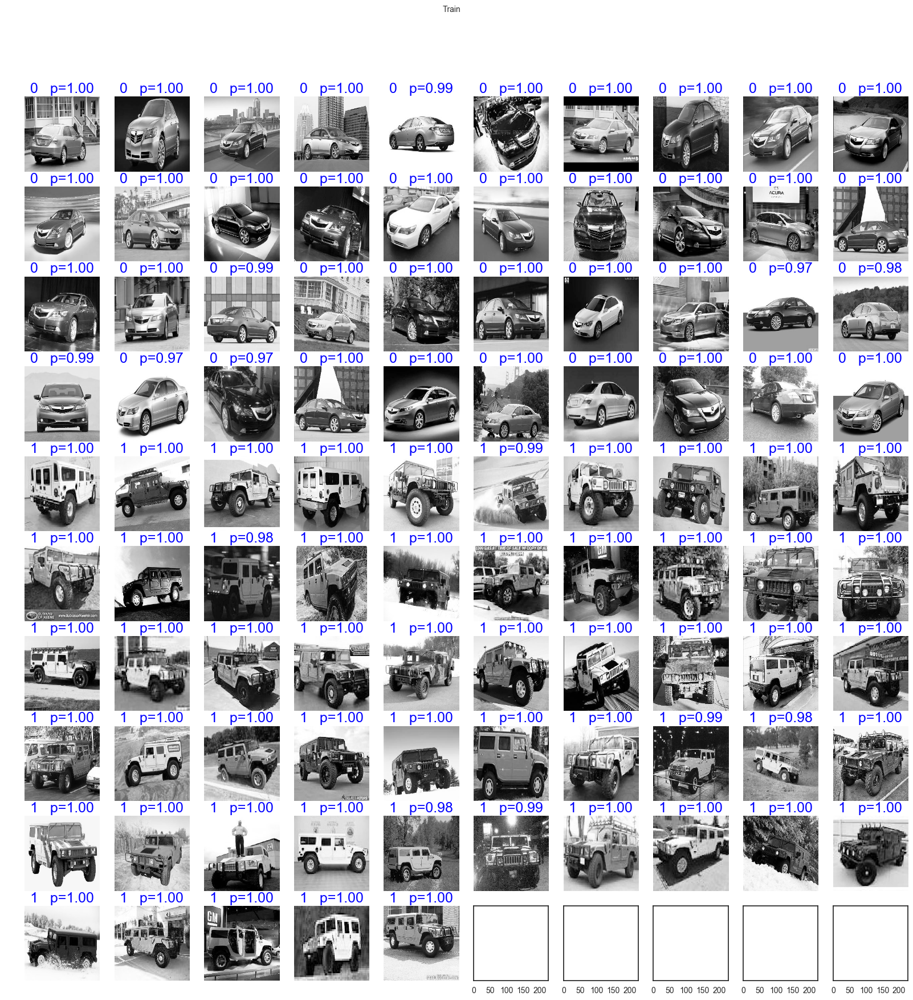

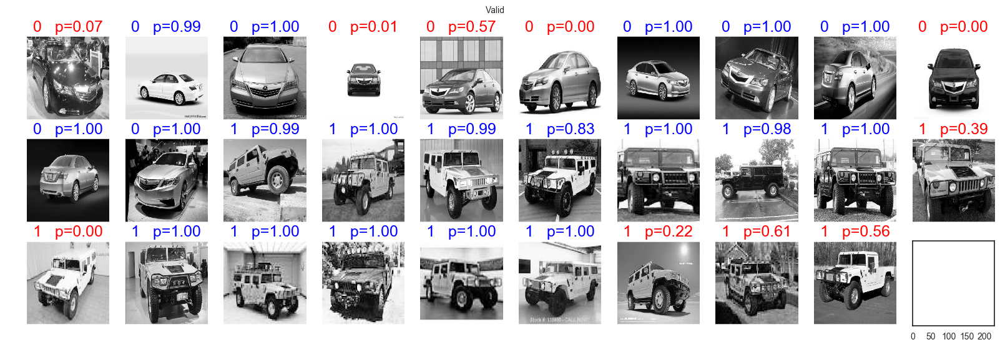

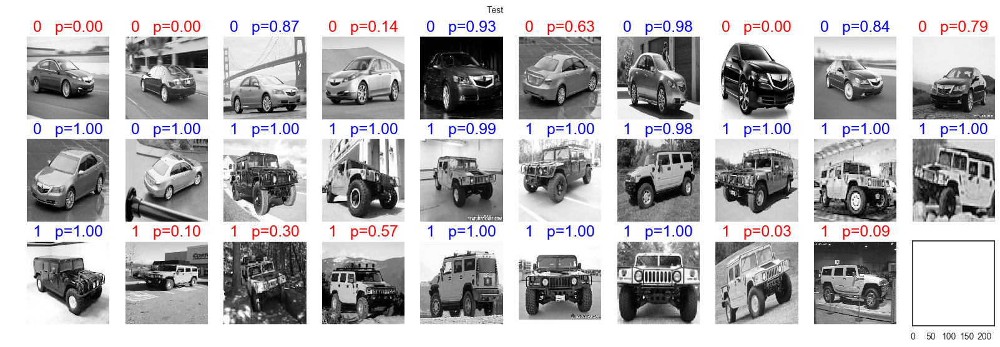

In [71]:
fig = plot_data(X_train_gray, Y_train, predict_train)
fig.suptitle("Train")

fig = plot_data(X_valid_gray, Y_valid, predict_valid)
fig.suptitle("Valid")

fig = plot_data(X_test_gray, Y_test, predict_test)
fig.suptitle("Test")

Looking at this really highlights how little data we have. Probably not worth using 40% for validation and test. Cross-validation would be better, and with this little data, would probably be fast enough. Can definitely benefit from data augmentation too. 

On the other hand, looks like the images are pretty well centered -- bounding boxes might help a bit, but there are very few gross scale differences.

While we're building infrastructure, let's change above plots to include whether we got each example right and wrong. [done]

### Now, let's try a basic CNN

We'll use three conv layers, then fully connected one. We'll use dropout to try to fight overfitting...

In [38]:
# normalize the data, this time leaving it in color
def normalize_for_cnn(xs):
    ret = (xs / 255.0)
    return ret

In [78]:
X_train_norm = normalize_for_cnn(X_train)
X_valid_norm = normalize_for_cnn(X_valid)
X_test_norm = normalize_for_cnn(X_test)

In [79]:
X_train_norm.shape

(95, 227, 227, 3)

In [41]:
def cnn_model(use_dropout=True):
    model = Sequential()
    nb_filters = 16
    pool_size = (2,2)
    filter_size = 3
    nb_classes = 2
    
    with tf.name_scope("conv1") as scope:
        model.add(Convolution2D(nb_filters, filter_size,
                            input_shape=(227, 227, 3)))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=pool_size))
        if use_dropout:
            model.add(Dropout(0.5))

    with tf.name_scope("conv2") as scope:
        model.add(Convolution2D(nb_filters, filter_size))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=pool_size))
        if use_dropout:
            model.add(Dropout(0.5))

    with tf.name_scope("conv3") as scope:
        model.add(Convolution2D(nb_filters, filter_size))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=pool_size))
        if use_dropout:
            model.add(Dropout(0.5))

    with tf.name_scope("dense1") as scope:
        model.add(Flatten())
        model.add(Dense(16))
        model.add(Activation('relu'))
        if use_dropout:
            model.add(Dropout(0.5))

    with tf.name_scope("softmax") as scope:
        model.add(Dense(nb_classes))
        model.add(Activation('softmax'))
    return model

# Uncomment if getting a "Invalid argument: You must feed a value
# for placeholder tensor ..." when rerunning training. 
# K.clear_session() # https://github.com/fchollet/keras/issues/4499
    

model2 = cnn_model()
model2.compile(loss='categorical_crossentropy',
              optimizer='adadelta',
              metrics=['accuracy'])

In [42]:
print(model2.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 225, 225, 16)      448       
_________________________________________________________________
activation_6 (Activation)    (None, 225, 225, 16)      0         
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 112, 112, 16)      0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 112, 112, 16)      0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 110, 110, 16)      2320      
_________________________________________________________________
activation_7 (Activation)    (None, 110, 110, 16)      0         
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 55, 55, 16)        0         
__________

In [130]:
recompute = False

if recompute:
    
    # Save info during computation so we can see what's happening
    tbCallback = TensorBoard(
        log_dir='./graph', histogram_freq=1, 
        write_graph=False, write_images=False)
    
    # Fit the model!
    history = model2.fit(
        X_train_norm, Y_train,
        batch_size=16, nb_epoch=100, verbose=1,
        validation_data=(X_valid_norm, Y_valid),
        callbacks=[tbCallback]
    )
else:
    model2.load_weights('hummer_acura_simple_cnn.h5')

Train on 95 samples, validate on 29 samples
Epoch 1/100
95/95 [==============================] - 5s - loss: 0.6914 - acc: 0.5579 - val_loss: 0.6880 - val_acc: 0.5862
Epoch 2/100
95/95 [==============================] - 5s - loss: 0.6856 - acc: 0.5895 - val_loss: 0.6893 - val_acc: 0.6552
Epoch 3/100
95/95 [==============================] - 5s - loss: 0.6683 - acc: 0.5368 - val_loss: 0.6863 - val_acc: 0.6552
Epoch 4/100
95/95 [==============================] - 5s - loss: 0.6782 - acc: 0.5789 - val_loss: 0.6887 - val_acc: 0.6552
Epoch 5/100
95/95 [==============================] - 4s - loss: 0.6738 - acc: 0.5579 - val_loss: 0.6829 - val_acc: 0.6207
Epoch 6/100
95/95 [==============================] - 5s - loss: 0.6751 - acc: 0.5684 - val_loss: 0.6877 - val_acc: 0.6552
Epoch 7/100
95/95 [==============================] - 5s - loss: 0.6600 - acc: 0.6316 - val_loss: 0.6863 - val_acc: 0.7241
Epoch 8/100
95/95 [==============================] - 5s - loss: 0.6572 - acc: 0.6737 - val_loss: 0.687

In [326]:
model2.save('hummer_acura_simple_cnn.h5')

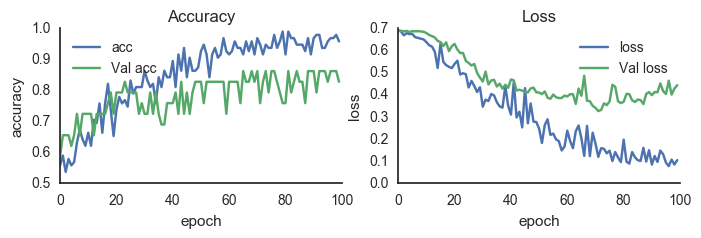

In [131]:
plot_training_curves(history.history);

In [132]:
score = model2.evaluate(X_test_norm, Y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

('Test loss:', 0.23822678625583649)
('Test accuracy:', 0.93103450536727905)


Hmm. Seems to work remarkably well, given how little data we have! Yay for dropout. We can move on to a more interesting problem, but first, let's look at a few things:
- take a look at the network in a bit more detail
- try it on some hummer, acura, and other photos from the internet.
- See how much dropout is helping...

First, let's take a look at the results:

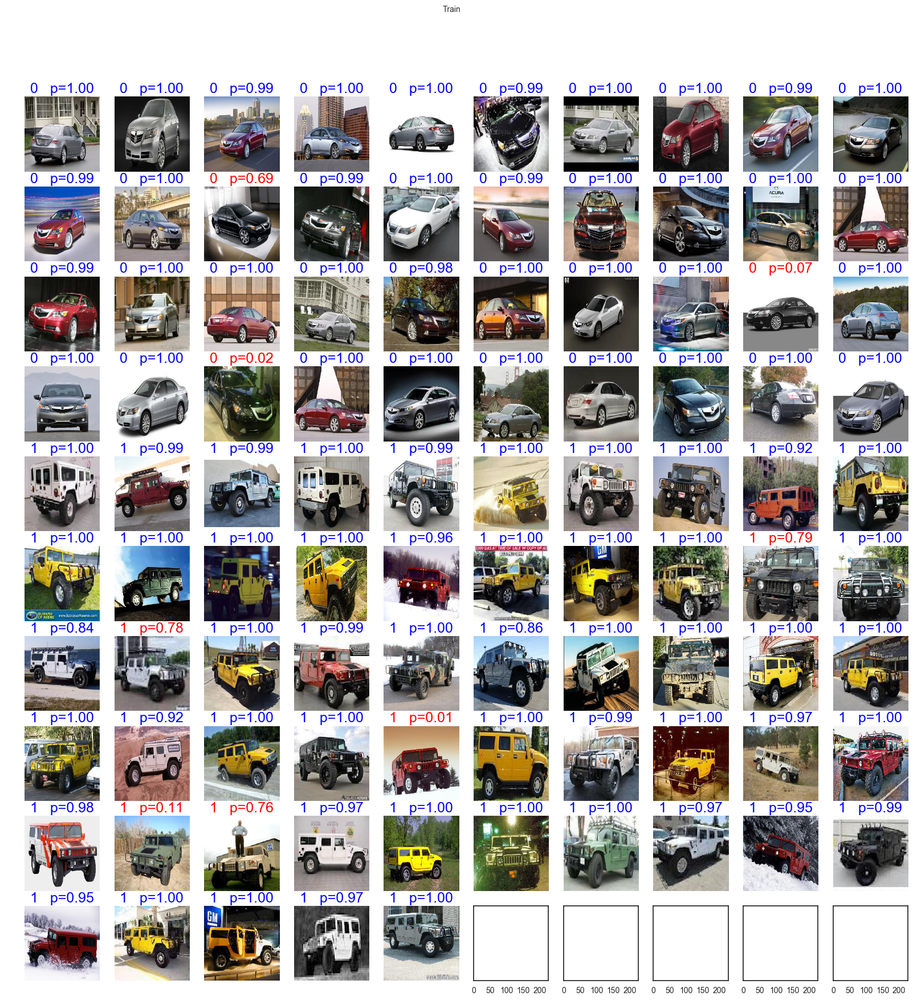

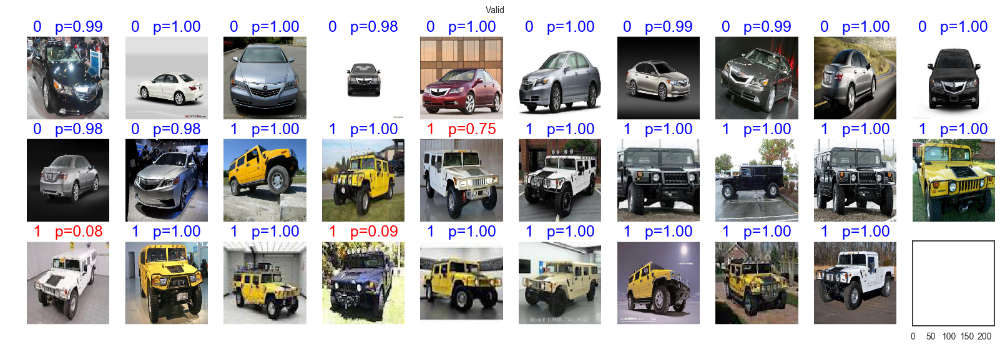

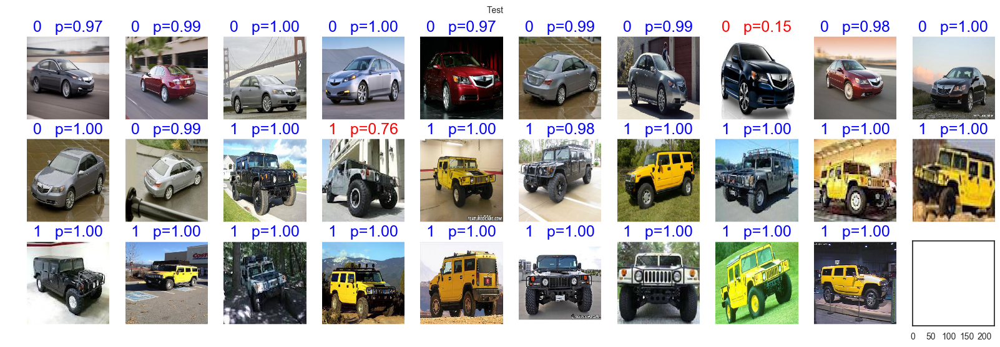

In [84]:
predict_train = model2.predict(X_train_norm)
predict_valid = model2.predict(X_valid_norm)
predict_test = model2.predict(X_test_norm)

fig = plot_data(X_train_norm, Y_train, predict_train)
fig.suptitle("Train")

fig = plot_data(X_valid_norm, Y_valid, predict_valid)
fig.suptitle("Valid")

fig = plot_data(X_test_norm, Y_test, predict_test)
fig.suptitle("Test")

Ok, now let's see how the same model does without dropout. Given how little data we have, I'd expect it to do a lot worse...

In [92]:
model2_nodropout = cnn_model(use_dropout=False)
model2_nodropout.compile(loss='categorical_crossentropy',
              optimizer='adadelta',
              metrics=['accuracy'])

In [93]:
history = model2_nodropout.fit(X_train_norm, Y_train, 
                               batch_size=16, nb_epoch=100, verbose=1,
         validation_data=(X_valid_norm, Y_valid))

Train on 95 samples, validate on 29 samples
Epoch 1/100
95/95 [==============================] - 4s - loss: 0.6857 - acc: 0.5368 - val_loss: 0.6680 - val_acc: 0.5862
Epoch 2/100
95/95 [==============================] - 3s - loss: 0.6846 - acc: 0.5263 - val_loss: 0.6674 - val_acc: 0.5862
Epoch 3/100
95/95 [==============================] - 3s - loss: 0.6758 - acc: 0.6000 - val_loss: 0.6609 - val_acc: 0.6207
Epoch 4/100
95/95 [==============================] - 3s - loss: 0.6578 - acc: 0.6000 - val_loss: 0.6456 - val_acc: 0.7931
Epoch 5/100
95/95 [==============================] - 3s - loss: 0.6013 - acc: 0.6947 - val_loss: 0.9653 - val_acc: 0.5862
Epoch 6/100
95/95 [==============================] - 3s - loss: 0.6211 - acc: 0.7684 - val_loss: 0.5513 - val_acc: 0.8276
Epoch 7/100
95/95 [==============================] - 3s - loss: 0.5953 - acc: 0.8211 - val_loss: 0.5341 - val_acc: 0.7586
Epoch 8/100
95/95 [==============================] - 3s - loss: 0.4788 - acc: 0.8211 - val_loss: 0.441

('Test loss:', 1.6642777919769287)
('Test accuracy:', 0.79310345649719238)


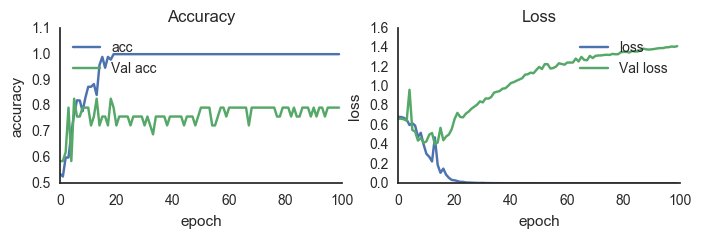

In [94]:
plot_training_curves(history.history);
score = model2_nodropoutropout.evaluate(X_test_norm, Y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Indeed, without dropout the network quickly gets a perfect training score and does not generalize at all. It's really amazing that dropout lets us train ~180K parameters with only 95 training images in a generalizable way! (See [this Geoff Hinton talk](https://www.youtube.com/watch?v=VIRCybGgHts&feature=youtu.be) for some discussion of why this works...)

## Novel data from the internet

Let's look at a few images from the internet. I found these manually. To be scientific, we'd want to get more data. For now, just getting an initial sense.

In [43]:
def image_from_url(url):
    response = requests.get(url)
    img = Image.open(StringIO(response.content))
    return img

In [86]:
hummer_urls = [
    "https://upload.wikimedia.org/wikipedia/commons/thumb/5/58/2002-09-11-Marbella-22.jpg/220px-2002-09-11-Marbella-22.jpg",
    "https://s-media-cache-ak0.pinimg.com/originals/83/01/a0/8301a0d1d45e4a53e1a790fe79f6cbef.jpg",
    "http://vignette1.wikia.nocookie.net/asphalt/images/2/26/Hummer_h1.jpg/revision/latest?cb=20150120143504",
   ]

acura_urls = [
    "https://media.ed.edmunds-media.com/acura/rl/2012/oem/2012_acura_rl_sedan_base_fq_oem_6_500.jpg",
    "https://media.ed.edmunds-media.com/acura/rl/2012/oem/2012_acura_rl_sedan_base_fq_oem_3_500.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/thumb/f/fc/2005_Acura_RL_--_NHTSA.jpg/1200px-2005_Acura_RL_--_NHTSA.jpg"
]

hummers = map(image_from_url, hummer_urls)
acuras = map(image_from_url, acura_urls)

In [87]:
to_test = [img.resize((227,227))
           for img in hummers + acuras]
    
to_test = [np.array(img).astype('float32')/255.0
                    for img in to_test]

to_test = np.array(to_test)
to_test.shape

(6, 227, 227, 3)

In [88]:
predicts = model2.predict(to_test)
ys = np.array([[1,0],[1,0],[1,0],
              [0,1],[0,1],[0,1]])

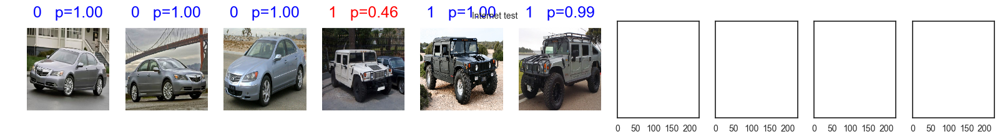

In [89]:
fig = plot_data(to_test, ys, predicts)
fig.suptitle("Internet test")

It seems to work ok. Just for fun, let's make sure we don't already have these images -- the original dataset was probably collected by googling too.

In [96]:
def cmp_images(a,b):
    """
    Compare two images. Both must be numpy arrays, of same size, 
    float32 normalized to [0,1].
    Approximate...
    """
    if np.abs((a-b)).mean() < 0.1:  # hack, but should be good enough
        return True
    return False

# mini test
cmp_images(X_train_norm[0], X_train_norm[0]), cmp_images(
    X_train_norm[0], X_train_norm[1])

(True, False)

In [91]:
stop = False
for a in it.chain(X_train_norm, X_valid_norm, X_test_norm):
    for b in to_test:
        if cmp_images(a,b):
            fig, plots = plt.subplots(1, 2)
            plots[0].imshow(a)
            plots[1].imshow(b)

## A note on puppies

Note that our classifier divides the world into hummer and acura, and has no conception of anything else. Let's see what it does with puppies...

In [410]:
puppy_urls = [
    "http://cdn.earthporm.com/wp-content/uploads/2015/10/XX-Proud-Mommies5__605.jpg",
    "https://ipetcompanion.com/feedapuppy/styles/media/puppy.jpg",
    "https://i.ytimg.com/vi/PnY7WqoN4F8/hqdefault.jpg"
]

puppies = map(image_from_url, puppy_urls)

In [411]:
to_test = [img.resize((227,227))
           for img in puppies]
    
to_test = [np.array(img).astype('float32')/255.0
                    for img in to_test]

to_test = np.array(to_test)
to_test.shape

(3, 227, 227, 3)

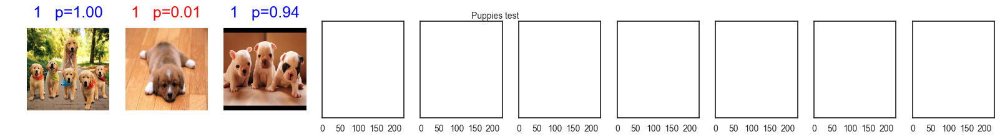

In [412]:
predicts = model2.predict(to_test)
# We'll pretend that puppies are hummers, just to make the code happy
ys = np.array([[1,0],[1,0],[1,0]])
fig = plot_data(to_test, ys, predicts)
fig.suptitle("Puppies test")

And voila -- we have two Hummer puppies and an acura puppy. The lesson: either ensure that you're only feeding your classifier data from one of the expected classes, or prepare to handle inputs that don't belong. We can include a none-of-the-above class, or predict the prob of each class independently, without using a softmax, so they can all be low at once. Either way, we'd need to feed our network enough negative data.

As a final step before moving on to a more complex problem, let's add TensorBoard so we can look at what's happening in our network. 
   - Result: TensorBoard doesn't seem to work very well with Keras yet. Layer names are messed up, so graph looks wonky. Histograms seem to work ok though.

# Problem 2

Ok, now we have basic pipeline working... let's try a more complex problem: 

- classify images as sedan, SUV, pickup, or none of the above.
- we'll use our Cars dataset, perhaps augmented with some random images

## Create our new class hierarchy

As a first step, let's finish up our car model classification into sedan, SUV, etc.

In [133]:
classes

[u'AM General Hummer SUV 2000',
 u'Acura RL Sedan 2012',
 u'Acura TL Sedan 2012',
 u'Acura TL Type-S 2008',
 u'Acura TSX Sedan 2012',
 u'Acura Integra Type R 2001',
 u'Acura ZDX Hatchback 2012',
 u'Aston Martin V8 Vantage Convertible 2012',
 u'Aston Martin V8 Vantage Coupe 2012',
 u'Aston Martin Virage Convertible 2012',
 u'Aston Martin Virage Coupe 2012',
 u'Audi RS 4 Convertible 2008',
 u'Audi A5 Coupe 2012',
 u'Audi TTS Coupe 2012',
 u'Audi R8 Coupe 2012',
 u'Audi V8 Sedan 1994',
 u'Audi 100 Sedan 1994',
 u'Audi 100 Wagon 1994',
 u'Audi TT Hatchback 2011',
 u'Audi S6 Sedan 2011',
 u'Audi S5 Convertible 2012',
 u'Audi S5 Coupe 2012',
 u'Audi S4 Sedan 2012',
 u'Audi S4 Sedan 2007',
 u'Audi TT RS Coupe 2012',
 u'BMW ActiveHybrid 5 Sedan 2012',
 u'BMW 1 Series Convertible 2012',
 u'BMW 1 Series Coupe 2012',
 u'BMW 3 Series Sedan 2012',
 u'BMW 3 Series Wagon 2012',
 u'BMW 6 Series Convertible 2007',
 u'BMW X5 SUV 2007',
 u'BMW X6 SUV 2012',
 u'BMW M3 Coupe 2012',
 u'BMW M5 Sedan 2010',
 

Looks good. Now let's split into (brand, model, type, year tuples). This will require a bit of manual munging...

In [44]:
# pull out brands -- will need a bit of massaging for two-word names
# like aston martin and land rover
pd.unique([c.split()[0] for c in classes])

array([u'AM', u'Acura', u'Aston', u'Audi', u'BMW', u'Bentley', u'Bugatti',
       u'Buick', u'Cadillac', u'Chevrolet', u'Chrysler', u'Daewoo',
       u'Dodge', u'Eagle', u'FIAT', u'Ferrari', u'Fisker', u'Ford', u'GMC',
       u'Geo', u'HUMMER', u'Honda', u'Hyundai', u'Infiniti', u'Isuzu',
       u'Jaguar', u'Jeep', u'Lamborghini', u'Land', u'Lincoln', u'MINI',
       u'Maybach', u'Mazda', u'McLaren', u'Mercedes-Benz', u'Mitsubishi',
       u'Nissan', u'Plymouth', u'Porsche', u'Ram', u'Rolls-Royce',
       u'Scion', u'Spyker', u'Suzuki', u'Tesla', u'Toyota', u'Volkswagen',
       u'Volvo', u'smart'], dtype=object)

In [45]:
# pull out car types
pd.unique([c.split()[-2] for c in classes])

array([u'SUV', u'Sedan', u'Type-S', u'R', u'Hatchback', u'Convertible',
       u'Coupe', u'Wagon', u'GS', u'Cab', u'ZR1', u'Z06', u'SS', u'Van',
       u'Minivan', u'SRT-8', u'SRT8', u'Abarth', u'SuperCab', u'IPL',
       u'XKR', u'Superleggera'], dtype=object)

In [46]:
def parse_classes(classes):
    """
    Return (id, brand, model, type, year) tuples.
    Type will be one of:
       * Sedan
       * Convertible
       * Coupe
       * SUV
       * Pickup
       * Van
       * Wagon
       
    We may combine these further later...
    """
    brands = [u'AM', u'Acura', u'Aston Martin', u'Audi', u'BMW', u'Bentley', u'Bugatti',
       u'Buick', u'Cadillac', u'Chevrolet', u'Chrysler', u'Daewoo',
       u'Dodge', u'Eagle', u'FIAT', u'Ferrari', u'Fisker', u'Ford', u'GMC',
       u'Geo', u'HUMMER', u'Honda', u'Hyundai', u'Infiniti', u'Isuzu',
       u'Jaguar', u'Jeep', u'Lamborghini', u'Land Rover', u'Lincoln', u'MINI',
       u'Maybach', u'Mazda', u'McLaren', u'Mercedes-Benz', u'Mitsubishi',
       u'Nissan', u'Plymouth', u'Porsche', u'Ram', u'Rolls-Royce',
       u'Scion', u'Spyker', u'Suzuki', u'Tesla', u'Toyota', u'Volkswagen',
       u'Volvo', u'smart']
    
    car_types = ['SUV', 'Sedan', 'Convertible', 'Coupe', 
                 'Wagon', 'Minivan', 'Van']
    # Some types we'll just remap
    # (Used Google image search to figure out some of these).
    car_type_map = {'Hatchback': 'Wagon',
                    'SuperCab' : 'Pickup',
                    'Type-S' : 'Sedan',
                    'Type R' : 'Coupe',
                    'Cab' : 'Pickup',
                    'GS': 'Sedan',
                    'ZR1' : 'Coupe',
                    'Z06' : 'Coupe',
                    'HHR SS' : 'SUV',
                    'Cobalt SS': 'Coupe',
                    'TrailBlazer SS': 'SUV',
                    '300 SRT-8': 'Sedan',
                    'Challenger SRT8' : 'Coupe',
                    'Charger SRT-8': 'Sedan',
                    # different style coupe -- I expect difficulties with
                    # the fiat 500...
                    '500 Abarth': 'Coupe',
                    'Coupe IPL': 'Coupe',
                    'XKR' : 'Coupe',
                    'Superleggera' : 'Coupe'
                   }
                    
    ret = []                
    for i, cls in enumerate(classes):
        words = cls.split()
        year = words[-1]
        if words[-2] in car_types:
            car_type = words[-2]
        elif words[-2] in car_type_map:
            car_type = car_type_map[words[-2]]
        else:
            # look for last two words match
            key = words[-3] + " " + words[-2]
            if key in car_type_map:
                car_type = car_type_map[key]
            else:
                print("Unknown car type: ", cls)
        
        # make sure everything is unicode to avoid any
        # issues later
        car_type = unicode(car_type)
        
        # just search
        for b in brands:
            if b in cls:
                brand = b
                brand_len = len(brand.split())

        # this will be approximate, but I don't really care
        # about the model, at least for now
        model = " ".join(words[brand_len:-2])
        # Careful! Class ids start at 1
        ret.append((i+1, brand, model, car_type, year))

    return ret

cls_tuples = parse_classes(classes)
cls_tuples

[(1, u'AM', u'General Hummer', u'SUV', u'2000'),
 (2, u'Acura', u'RL', u'Sedan', u'2012'),
 (3, u'Acura', u'TL', u'Sedan', u'2012'),
 (4, u'Acura', u'TL', u'Sedan', u'2008'),
 (5, u'Acura', u'TSX', u'Sedan', u'2012'),
 (6, u'Acura', u'Integra Type', u'Coupe', u'2001'),
 (7, u'Acura', u'ZDX', u'Wagon', u'2012'),
 (8, u'Aston Martin', u'V8 Vantage', u'Convertible', u'2012'),
 (9, u'Aston Martin', u'V8 Vantage', u'Coupe', u'2012'),
 (10, u'Aston Martin', u'Virage', u'Convertible', u'2012'),
 (11, u'Aston Martin', u'Virage', u'Coupe', u'2012'),
 (12, u'Audi', u'RS 4', u'Convertible', u'2008'),
 (13, u'Audi', u'A5', u'Coupe', u'2012'),
 (14, u'Audi', u'TTS', u'Coupe', u'2012'),
 (15, u'Audi', u'R8', u'Coupe', u'2012'),
 (16, u'Audi', u'V8', u'Sedan', u'1994'),
 (17, u'Audi', u'100', u'Sedan', u'1994'),
 (18, u'Audi', u'100', u'Wagon', u'1994'),
 (19, u'Audi', u'TT', u'Wagon', u'2011'),
 (20, u'Audi', u'S6', u'Sedan', u'2011'),
 (21, u'Audi', u'S5', u'Convertible', u'2012'),
 (22, u'Audi', u

In [47]:
by_car_type = {} # type -> [tuples]
key_fn = operator.itemgetter(3)
for ct, group in it.groupby(sorted(cls_tuples, key=key_fn), key_fn):
    by_car_type[ct] = list(group)

for k,v in sorted(by_car_type.items(), key=lambda x: len(x[1])):
    print(k, len(v))

(u'Minivan', 6)
(u'Van', 7)
(u'Pickup', 18)
(u'Wagon', 19)
(u'Convertible', 26)
(u'Coupe', 34)
(u'SUV', 36)
(u'Sedan', 50)


Hmm. Uneven number of car models per class. May make classification harder.

Ok, let's just try it with these classes -- load the images per class, give them appropriate labels. 

To make the model smaller, let's start with just 20 images per car.

In [48]:
# make a mapping from class name to numbers we can one-hot encode
macro_classes = sorted(pd.unique([c[3] for c in cls_tuples]))
macro_class_map = dict((v,k) for (k,v) in enumerate(macro_classes))
macro_class_map

{u'Convertible': 0,
 u'Coupe': 1,
 u'Minivan': 2,
 u'Pickup': 3,
 u'SUV': 4,
 u'Sedan': 5,
 u'Van': 6,
 u'Wagon': 7}

Let's save some metadata so we can load it in other notebooks -- this one is getting rather unwieldy.

In [66]:
import cPickle as pickle

save = True
if save:
    with open('class_details.pkl','w') as f:
        pickle.dump({'classes' : classes,
                     'examples' : examples,
                     'by_class' : by_class,
                     'by_car_type' : by_car_type,
                    'macro_classes' : macro_classes,
                    'macro_class_map': macro_class_map,
                    'cls_tuples': cls_tuples}, f)

## Load and split the data

In [49]:
IMG_PER_CAR = None # 20 # None to use all
valid_frac = 0.2
test_frac = 0.2

train = []
valid = []
test = []
for car_type, model_tuples in by_car_type.items():
    macro_class_id = macro_class_map[car_type]
    
    for model_tpl in model_tuples:
        cls = model_tpl[0]
        examples = load_examples(by_class, cls, limit=IMG_PER_CAR)
        # replace class labels with the id of the macro class
        examples = [(X, macro_class_id) for (X,y) in examples]
        # split each class separately, so all have same fractions of 
        # train/valid/test
        (cls_train, cls_valid, cls_test) = split_examples(
            examples,
            valid_frac, test_frac)
        # and add them to the overall train/valid/test sets
        train.extend(cls_train)
        valid.extend(cls_valid)
        test.extend(cls_test)

# ...and shuffle to make training work better.
np.random.shuffle(train)
np.random.shuffle(valid)
np.random.shuffle(test)

Still copy-pasting from above. Could refactor...

In [50]:
# We have lists of (X,Y) tuples. Let's unzip into lists of Xs and Ys.
X_train, Y_train = zip(*train)
X_valid, Y_valid = zip(*valid)
X_test, Y_test = zip(*test)

# and turn into np arrays of the right dimension.
def convert_X(xs):
    '''
    Take list of (w,h,3) images.
    Turn into an np array, change type to float32.
    '''
    return np.array(xs).astype('float32')
    
X_train = convert_X(X_train)
X_valid = convert_X(X_valid)
X_test = convert_X(X_test)

In [51]:
X_train.shape

(9867, 227, 227, 3)

## Convert to one-hot

In [53]:
def convert_Y(ys, macro_classes):
    '''
    Convert to np array, make one-hot.
    Already ensured they're sequential from zero.
    '''
    n_classes = len(macro_classes)
    return np_utils.to_categorical(ys, n_classes)

Y_train = convert_Y(Y_train, macro_classes)
Y_valid = convert_Y(Y_valid, macro_classes)
Y_test = convert_Y(Y_test, macro_classes)

In [54]:
Y_train.shape

(9867, 8)

In [55]:
# normalize the data, this time leaving it in color
X_train_norm = normalize_for_cnn(X_train)
X_valid_norm = normalize_for_cnn(X_valid)
X_test_norm = normalize_for_cnn(X_test)

## Build our model.

In [167]:
# Let's use more or less the same model to start (num classes changes)
def cnn_model2(use_dropout=True):
    model = Sequential()
    nb_filters = 16
    pool_size = (2,2)
    filter_size = 3
    nb_classes = len(macro_classes)
    
    with tf.name_scope("conv1") as scope:
        model.add(Convolution2D(nb_filters, filter_size, 
                            input_shape=(227, 227, 3)))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=pool_size))
        if use_dropout:
            model.add(Dropout(0.5))

    with tf.name_scope("conv2") as scope:
        model.add(Convolution2D(nb_filters, filter_size))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=pool_size))
        if use_dropout:
            model.add(Dropout(0.5))

    with tf.name_scope("conv3") as scope:
        model.add(Convolution2D(nb_filters, filter_size))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=pool_size))
        if use_dropout:
            model.add(Dropout(0.5))

    with tf.name_scope("dense1") as scope:
        model.add(Flatten())
        model.add(Dense(16))
        model.add(Activation('relu'))
        if use_dropout:
            model.add(Dropout(0.5))

    with tf.name_scope("softmax") as scope:
        model.add(Dense(nb_classes))
        model.add(Activation('softmax'))
    return model

# Uncomment if getting a "Invalid argument: You must feed a value
# for placeholder tensor ..." when rerunning training. 
# K.clear_session() # https://github.com/fchollet/keras/issues/4499
    

model3 = cnn_model2()
model3.compile(loss='categorical_crossentropy',
              optimizer='adadelta',
              metrics=['accuracy'])

In [168]:
# This model will train slowly, so let's checkpoint it periodically
from keras.callbacks import ModelCheckpoint

## Train the model...

In [169]:
recompute = False

if recompute:
#     # Save info during computation so we can see what's happening
#     tbCallback = TensorBoard(
#         log_dir='./graph', histogram_freq=1, 
#         write_graph=False, write_images=False)

    checkpoint = ModelCheckpoint('macro_class_cnn_checkpoint.5',
                                 monitor='val_acc',
                                 verbose=1,
                                 save_best_only=True, mode='max',
                                 save_weights_only=True)

    # Fit the model! Using a bigger batch size and fewer epochs
    # because we have ~10K training images now instead of 100.
    history = model3.fit(
        X_train_norm, Y_train,
        batch_size=64, nb_epoch=50, verbose=1,
        validation_data=(X_valid_norm, Y_valid),
        callbacks=[checkpoint]
    )
else:
    model3.load_weights('macro_class_cnn.h5')

Train on 9867 samples, validate on 3159 samples
Epoch 1/50
9867/9867 [==============================] - 471s - loss: 2.0055 - acc: 0.2247 - val_loss: 2.0049 - val_acc: 0.2558
Epoch 2/50
9867/9867 [==============================] - 393s - loss: 1.9587 - acc: 0.2312 - val_loss: 1.9725 - val_acc: 0.1912
Epoch 3/50
9867/9867 [==============================] - 377s - loss: 1.9287 - acc: 0.2419 - val_loss: 1.9587 - val_acc: 0.2995
Epoch 4/50
9867/9867 [==============================] - 363s - loss: 1.9059 - acc: 0.2587 - val_loss: 1.8863 - val_acc: 0.2881
Epoch 5/50
9867/9867 [==============================] - 356s - loss: 1.8895 - acc: 0.2719 - val_loss: 1.8866 - val_acc: 0.2919
Epoch 6/50
9867/9867 [==============================] - 354s - loss: 1.8785 - acc: 0.2729 - val_loss: 1.9138 - val_acc: 0.2991
Epoch 7/50
9867/9867 [==============================] - 360s - loss: 1.8673 - acc: 0.2817 - val_loss: 1.8759 - val_acc: 0.2906
Epoch 8/50
9867/9867 [==============================] - 355s - 

In [ ]:
if False:  # change to True to save new weights
    model3.save('macro_class_cnn.h5')

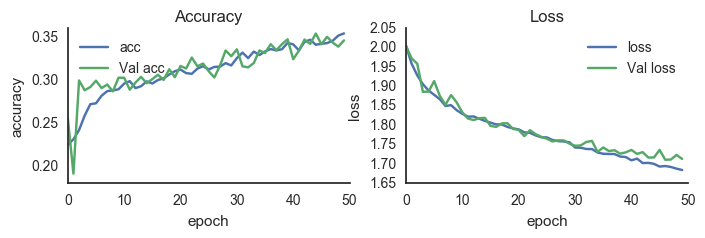

In [170]:
plot_training_curves(history.history);

In [173]:
# let's train some more -- clearly still getting better
history2 = model3.fit(
    X_train_norm, Y_train,
    batch_size=64, nb_epoch=50, verbose=1,
    validation_data=(X_valid_norm, Y_valid),
    callbacks=[checkpoint])


Train on 9867 samples, validate on 3159 samples
Epoch 1/50
9867/9867 [==============================] - 367s - loss: 1.6812 - acc: 0.3503 - val_loss: 1.7217 - val_acc: 0.3406
Epoch 2/50
9867/9867 [==============================] - 356s - loss: 1.6832 - acc: 0.3465 - val_loss: 1.6938 - val_acc: 0.3539
Epoch 3/50
9867/9867 [==============================] - 355s - loss: 1.6843 - acc: 0.3466 - val_loss: 1.7102 - val_acc: 0.3561
Epoch 4/50
9867/9867 [==============================] - 352s - loss: 1.6783 - acc: 0.3619 - val_loss: 1.7195 - val_acc: 0.3412
Epoch 5/50
9867/9867 [==============================] - 351s - loss: 1.6803 - acc: 0.3576 - val_loss: 1.7068 - val_acc: 0.3536
Epoch 6/50
9867/9867 [==============================] - 353s - loss: 1.6729 - acc: 0.3580 - val_loss: 1.7430 - val_acc: 0.3204
Epoch 7/50
9867/9867 [==============================] - 354s - loss: 1.6703 - acc: 0.3606 - val_loss: 1.6957 - val_acc: 0.3558
Epoch 8/50
9867/9867 [==============================] - 351s - 

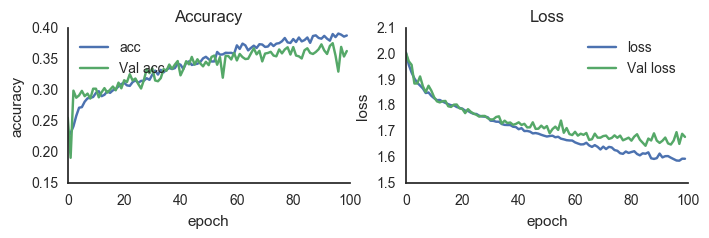

In [180]:
from helpers import combine_histories
plot_training_curves(combine_histories(history.history, history2.history));

## Diagnosing...

The model is starting to overfit. Let's try to diagnose what's going on, then decide what to do.

Now that we have 8 different classes, we can see how often they get confused for each other by looking at the aptly named confusion matrix. I would expect lots of confusion between coupe and sedan, and van and minivan, and suv and wagon. 

In [190]:
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(labels, predictions,
                          classes,
                          normalize=False,
                          title="Confusion matrix",
                          cmap=plt.cm.Blues):
    """
    Plot a confusion matrix for predictions vs labels. 
    Both should be one-hot.
    
    Based on.
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html    
    """
    # convert from one-hot
    cat_labels = np.argmax(labels, axis=1)
    cat_predicts = np.argmax(predictions, axis=1)
    
    cm = confusion_matrix(cat_labels, cat_predicts)
    
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()    
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in it.product(range(cm.shape[0]), range(cm.shape[1])):
        if 0 < cm[i,j] < 1:
            val = "{:.2f}".format(cm[i,j])
        else:
            val = cm[i,j]
        plt.text(j, i, val,
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')



In [182]:
# Get the predictions
predict_train = model3.predict(X_train_norm)
predict_valid = model3.predict(X_valid_norm)
predict_test = model3.predict(X_test_norm)

Confusion matrix, without normalization
[[ 12  49   0   5  49 286   0   0]
 [ 10  98   0   2  46 390   0   0]
 [  0   0   0   0  20  77   0   0]
 [  1   4   0  31 162  99   0   0]
 [  4  10   0  13 290 270   0   0]
 [  2  35   0   0  92 675   0   0]
 [  1   5   0   2  43  62   0   0]
 [  1  22   0   4  43 244   0   0]]


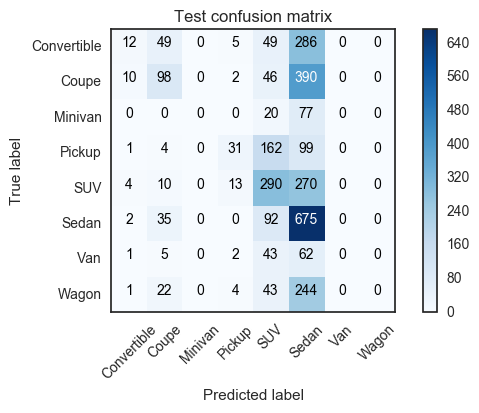

In [192]:
plot_confusion_matrix(Y_test, predict_test, macro_classes,
                      normalize=False,
                      title="Test confusion matrix");

Confusion matrix, without normalization
[[  78  156    0    3  105  914    0    0]
 [  17  593    0    3   82 1014    0    0]
 [   0    3    0    0   65  236    0    0]
 [   0    2    0  241  406  271    0    0]
 [   3   11    0   14 1182  624    0    0]
 [   0   21    0    2  179 2312    0    0]
 [   0    2    0    5  125  220    0    0]
 [   0   33    0    3  124  818    0    0]]


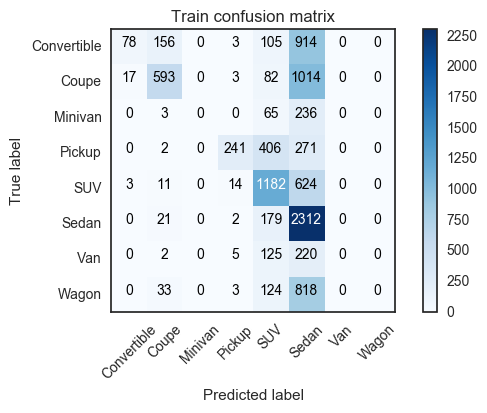

In [193]:
plot_confusion_matrix(Y_train, predict_train, macro_classes,
                      title="Train confusion matrix")

In [ ]:
plot_confusion_matrix(Y_train, predict_train, macro_classes,
                      
                      title="Train confusion matrix")

Well, it seems that most car types are classified as sedan. Not too surprising, especially given that sedans are overrepresented. It's starting to learn that SUVs and pickups are different from sedans, and occasionally manages to distinguish coupes from sedans. 

So far, it doesn't use minivan, van, or wagon labels at all.

Things to check / do:
- Is it correctly getting coupe images from the side, incorrectly from the front or back?
- Look at class probabilities for some images, not just the maximal one
- Count how many training images we have for each class. May want to oversample the low prob classes.
- Try fine-tuning an off-the-shelf model.

## To be continued

We'll pick up in [10b-cars-continued.ipynb](10b-cars-continued.ipynb)...